In [7]:
# %%
import os
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, BatchNormalization, Activation, MaxPooling2D, UpSampling2D, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from sklearn.model_selection import train_test_split
import numpy as np
import cv2
from glob import glob
import matplotlib.pyplot as plt

# Suppress TensorFlow Logging
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"


In [8]:
# %%
def conv_block(inputs, filters):
    x = Conv2D(filters, (3, 3), padding="same")(inputs)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(filters, (3, 3), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    return x

def encoder_block(inputs, filters):
    x = conv_block(inputs, filters)
    p = MaxPooling2D((2, 2))(x)
    return x, p

def decoder_block(inputs, skip, filters):
    x = UpSampling2D((2, 2))(inputs)
    x = Concatenate()([x, skip])
    x = conv_block(x, filters)
    return x

def build_unet(input_shape=(256, 256, 3), num_classes=4):
    inputs = Input(input_shape)

    # Encoder
    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)
    s3, p3 = encoder_block(p2, 256)
    s4, p4 = encoder_block(p3, 512)

    # Bridge
    b = conv_block(p4, 1024)

    # Decoder
    d1 = decoder_block(b, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    # Output
    outputs = Conv2D(num_classes, (1, 1), padding="same", activation="softmax")(d4)

    model = Model(inputs, outputs, name="U-Net")
    return model


In [9]:
# %%
def remap_mask_with_ranges(mask):
    remapped_mask = np.zeros_like(mask)

    # Define ranges
    background_range = (0, 50)       # Background
    gray_range = (70, 150)           # Putih keabu-abuan
    white_gray_range = (170, 230)    # Putih abu-abu
    white_range = (231, 255)         # Putih terang

    # Apply ranges
    remapped_mask[(mask >= background_range[0]) & (mask <= background_range[1])] = 0
    remapped_mask[(mask >= gray_range[0]) & (mask <= gray_range[1])] = 1
    remapped_mask[(mask >= white_gray_range[0]) & (mask <= white_gray_range[1])] = 2
    remapped_mask[(mask >= white_range[0]) & (mask <= white_range[1])] = 3

    return remapped_mask

def preprocess_data(image_filenames, mask_filenames, target_size=(256, 256), num_classes=4):
    images, masks = [], []

    for img_path, mask_path in zip(image_filenames, mask_filenames):
        img = cv2.imread(img_path)
        if img is None:
            print(f"Warning: Unable to read image {img_path}. Skipping.")
            continue
        img = cv2.resize(img, target_size) / 255.0

        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if mask is None:
            print(f"Warning: Unable to read mask {mask_path}. Skipping.")
            continue
        mask = remap_mask_with_ranges(mask)
        mask = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        mask = tf.keras.utils.to_categorical(mask, num_classes=num_classes)

        images.append(img)
        masks.append(mask)

    return np.array(images), np.array(masks)


In [10]:
# %%
def mean_iou_custom(y_true, y_pred, num_classes=4):
    y_true = tf.argmax(y_true, axis=-1)
    y_pred = tf.argmax(y_pred, axis=-1)
    iou = 0.0
    for c in range(num_classes):
        y_true_c = K.cast(K.equal(y_true, c), 'float32')
        y_pred_c = K.cast(K.equal(y_pred, c), 'float32')
        intersection = K.sum(y_true_c * y_pred_c)
        union = K.sum(y_true_c) + K.sum(y_pred_c) - intersection
        iou += (intersection + K.epsilon()) / (union + K.epsilon())
    return iou / num_classes

def dice_coefficient(y_true, y_pred, num_classes=4):
    y_true = tf.argmax(y_true, axis=-1)
    y_pred = tf.argmax(y_pred, axis=-1)
    dice = 0.0
    for c in range(num_classes):
        y_true_c = K.cast(K.equal(y_true, c), 'float32')
        y_pred_c = K.cast(K.equal(y_pred, c), 'float32')
        intersection = K.sum(y_true_c * y_pred_c)
        denominator = K.sum(y_true_c) + K.sum(y_pred_c)
        dice += (2. * intersection + K.epsilon()) / (denominator + K.epsilon())
    return dice / num_classes


In [11]:
# %%
image_filenames = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_training/*'))     # Sesuaikan path dataset Anda
mask_filenames = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_training_gt/*'))       # Sesuaikan path dataset Anda

# Split dataset
image_train, image_val, mask_train, mask_val = train_test_split(
    image_filenames, mask_filenames, test_size=0.2, random_state=42
)

X_train, y_train = preprocess_data(image_train, mask_train)
X_val, y_val = preprocess_data(image_val, mask_val)


In [12]:
# %%
# Hyperparameter terbaik berdasarkan evaluasi Anda (bisa disesuaikan)
best_learning_rate = 0.001
best_batch_size = 4
best_optimizer = Adam(learning_rate=best_learning_rate)

unet_model = build_unet(input_shape=(256, 256, 3), num_classes=4)
unet_model.compile(
    optimizer=best_optimizer,
    loss=CategoricalCrossentropy(),
    metrics=["accuracy", mean_iou_custom, dice_coefficient]
)

callbacks = [
    EarlyStopping(monitor='val_mean_iou_custom', patience=10, restore_best_weights=True, mode='max'),
    ReduceLROnPlateau(monitor='val_mean_iou_custom', factor=0.2, patience=5, min_lr=1e-7, mode='max')
]

history = unet_model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=50,
    callbacks=callbacks,
    batch_size=best_batch_size,
    verbose=1
)


I0000 00:00:1734288951.965453   18499 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:26:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1734288952.003492   18499 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:26:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1734288952.003601   18499 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:26:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1734288952.007676   18499 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:26:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1734288952.007773   18499 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:26:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:0

Epoch 1/50


I0000 00:00:1734288962.858163   18747 service.cc:146] XLA service 0x7f81080040e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734288962.858224   18747 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 Ti, Compute Capability 8.9
2024-12-16 01:56:03.123001: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-12-16 01:56:03.982949: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907
2024-12-16 01:56:10.772241: W external/local_tsl/tsl/framework/bfc_allocator.cc:291] Allocator (GPU_0_bfc) ran out of memory trying to allocate 8.11GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-12-16 01:56:11.264307: W external/local_tsl/tsl/framework/bfc_allocator.cc:291]

  1/129 ━━━━━━━━━━━━━━━━━━━━ 49:12 23s/step - accuracy: 0.1642 - dice_coefficient: 0.0846 - loss: 1.6507 - mean_iou_custom: 0.0482

I0000 00:00:1734288978.165266   18747 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


129/129 ━━━━━━━━━━━━━━━━━━━━ 39s 128ms/step - accuracy: 0.8690 - dice_coefficient: 0.2302 - loss: 0.4633 - mean_iou_custom: 0.2201 - val_accuracy: 0.1661 - val_dice_coefficient: 0.0767 - val_loss: 9.7175 - val_mean_iou_custom: 0.0437 - learning_rate: 0.0010
Epoch 2/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 11s 86ms/step - accuracy: 0.9713 - dice_coefficient: 0.4258 - loss: 0.1115 - mean_iou_custom: 0.3641 - val_accuracy: 0.9522 - val_dice_coefficient: 0.2439 - val_loss: 11.6388 - val_mean_iou_custom: 0.2381 - learning_rate: 0.0010
Epoch 3/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 11s 85ms/step - accuracy: 0.9736 - dice_coefficient: 0.4835 - loss: 0.0949 - mean_iou_custom: 0.4062 - val_accuracy: 0.9590 - val_dice_coefficient: 0.2830 - val_loss: 0.1671 - val_mean_iou_custom: 0.2615 - learning_rate: 0.0010
Epoch 4/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 11s 85ms/step - accuracy: 0.9801 - dice_coefficient: 0.6089 - loss: 0.0631 - mean_iou_custom: 0.5106 - val_accuracy: 0.9683 - val_dice_coefficient: 0.4122 - val_loss

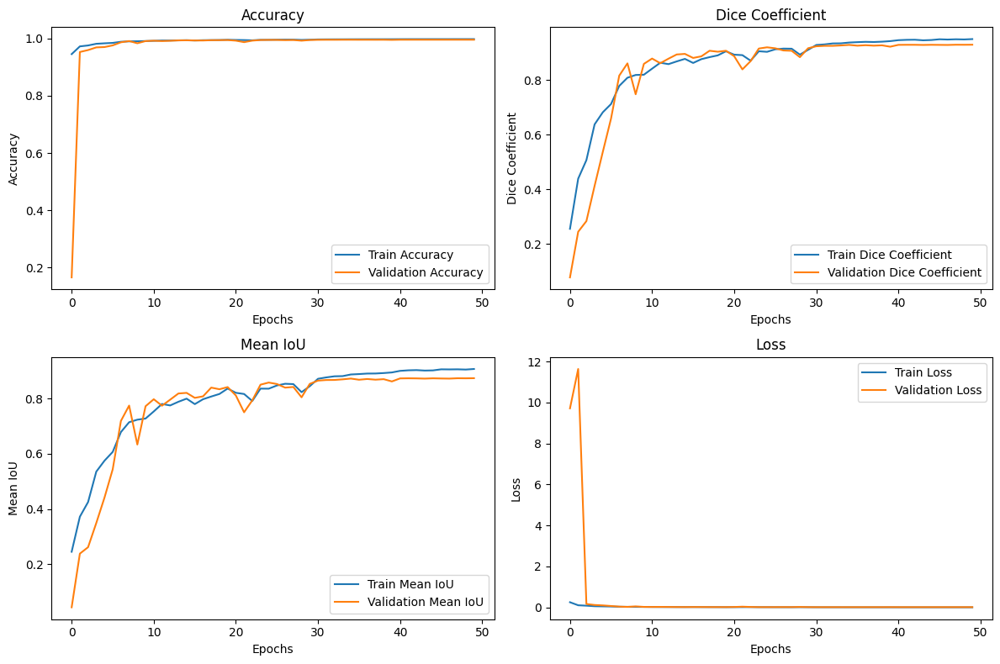

In [13]:
# %%
history_dict = history.history

plt.figure(figsize=(12, 8))

# Plot Accuracy
plt.subplot(2, 2, 1)
plt.plot(history_dict['accuracy'], label='Train Accuracy')
plt.plot(history_dict['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Plot Dice Coefficient
plt.subplot(2, 2, 2)
plt.plot(history_dict['dice_coefficient'], label='Train Dice Coefficient')
plt.plot(history_dict['val_dice_coefficient'], label='Validation Dice Coefficient')
plt.title('Dice Coefficient')
plt.xlabel('Epochs')
plt.ylabel('Dice Coefficient')
plt.legend()

# Plot Mean IoU
plt.subplot(2, 2, 3)
plt.plot(history_dict['mean_iou_custom'], label='Train Mean IoU')
plt.plot(history_dict['val_mean_iou_custom'], label='Validation Mean IoU')
plt.title('Mean IoU')
plt.xlabel('Epochs')
plt.ylabel('Mean IoU')
plt.legend()

# Plot Loss
plt.subplot(2, 2, 4)
plt.plot(history_dict['loss'], label='Train Loss')
plt.plot(history_dict['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


In [14]:
# %%
def calculate_metrics(y_true, y_pred, num_classes=4):
    iou_list = []
    dice_list = []

    for i in range(len(y_true)):
        true_mask = np.argmax(y_true[i], axis=-1)
        pred_mask = np.argmax(y_pred[i], axis=-1)

        for c in range(num_classes):
            true_c = (true_mask == c).astype(np.float32)
            pred_c = (pred_mask == c).astype(np.float32)

            intersection = np.sum(true_c * pred_c)
            union = np.sum(true_c) + np.sum(pred_c) - intersection
            iou = (intersection + 1e-6) / (union + 1e-6)
            iou_list.append(iou)

            dice = (2 * intersection + 1e-6) / (np.sum(true_c) + np.sum(pred_c) + 1e-6)
            dice_list.append(dice)

    mean_iou = np.mean(iou_list)
    mean_dice = np.mean(dice_list)

    return mean_iou, mean_dice

# Preprocessing test data
image_filenames_test = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_testing/*'))    # Sesuaikan path dataset Anda
mask_filenames_test = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_testing_gt/*'))      # Sesuaikan path dataset Anda

X_test, y_test = preprocess_data(image_filenames_test, mask_filenames_test)

# Predict on test data
predictions_test = unet_model.predict(X_test)

# Calculate test metrics
mean_iou_test, mean_dice_test = calculate_metrics(y_test, predictions_test, num_classes=4)
print(f"Test Mean IoU: {mean_iou_test:.4f}")
print(f"Test Mean Dice Coefficient: {mean_dice_test:.4f}")


2024-12-16 02:06:04.310499: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[32,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,192,256,256]{3,2,1,0}, f32[64,192,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0},"force_earliest_schedule":false} is taking a while...
2024-12-16 02:06:04.402011: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.091639725s
Trying algorithm eng0{} for conv (f32[32,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,192,256,256]{3,2,1,0}, f32[64,192,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend

8/8 ━━━━━━━━━━━━━━━━━━━━ 21s 1s/step 
Test Mean IoU: 0.7361
Test Mean Dice Coefficient: 0.8011


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step


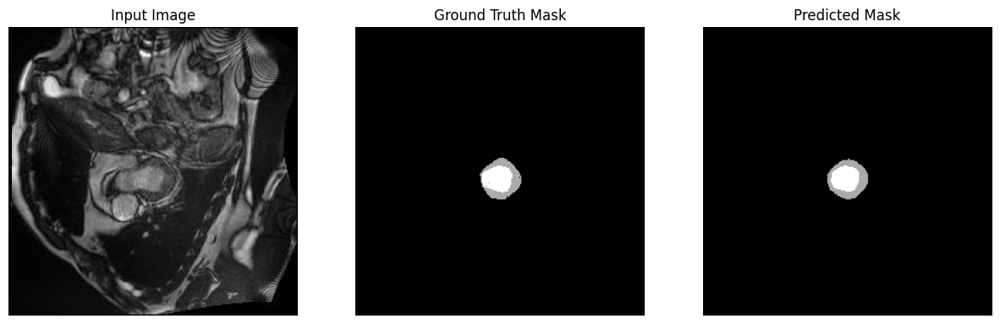

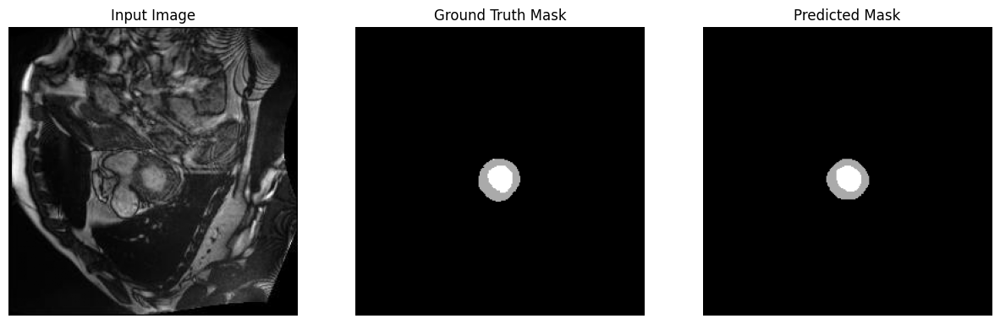

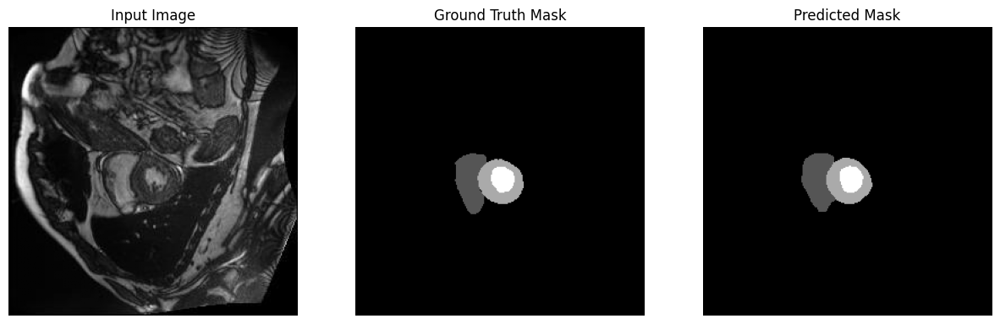

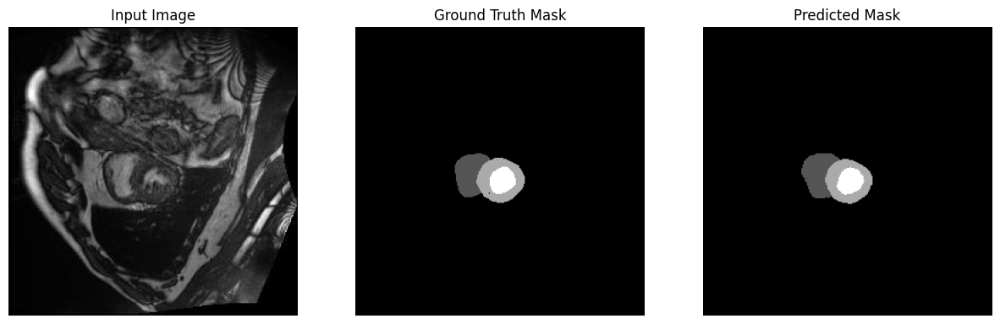

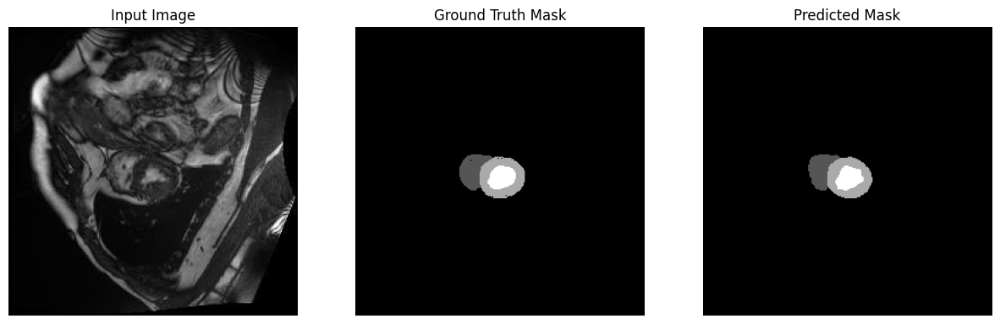

...

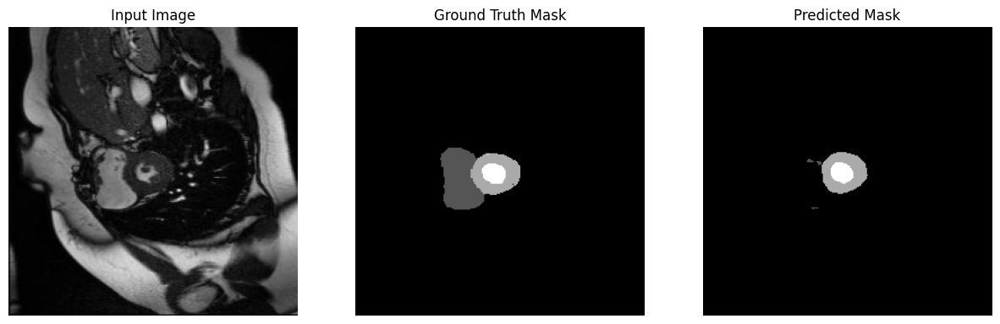

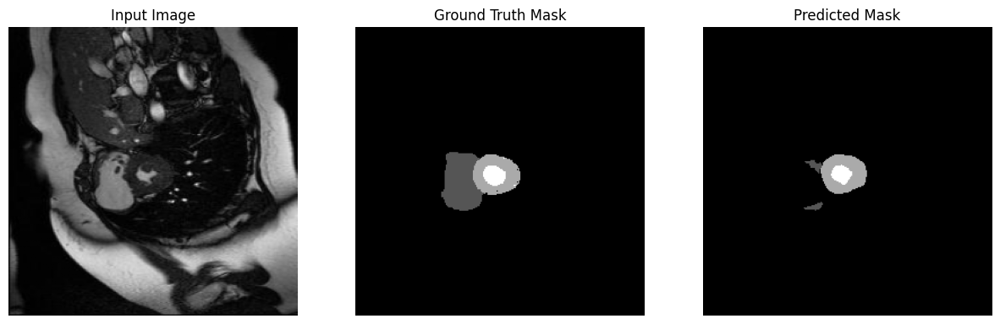

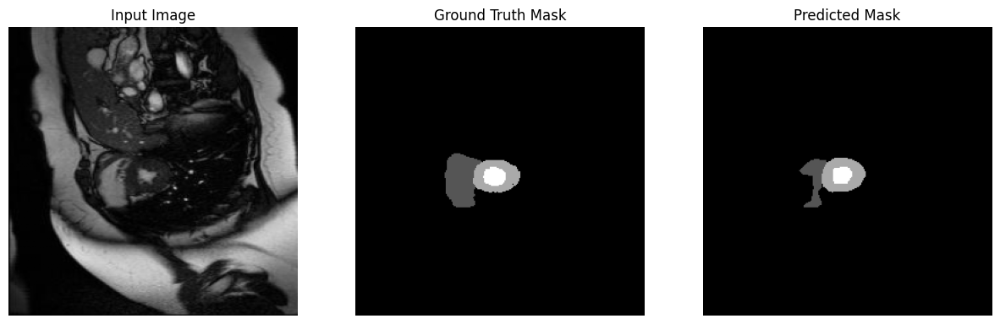

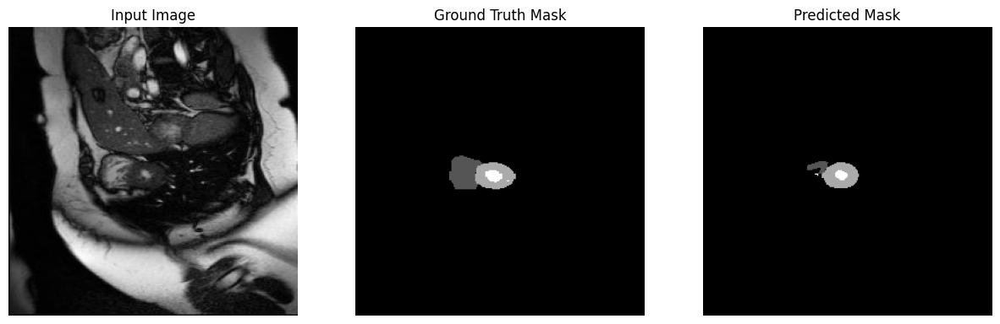

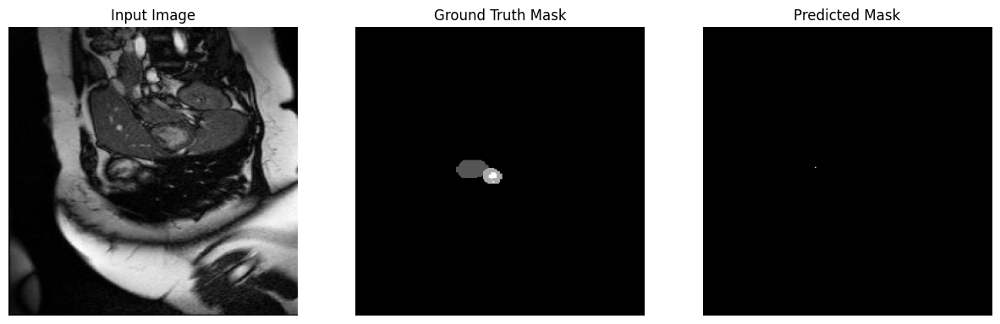

In [15]:
# %%
def visualize_predictions(model, X_test, mask_filenames, target_size=(256, 256)):
    predictions = model.predict(X_test)

    for i in range(len(X_test)):
        img = X_test[i]
        mask_path = mask_filenames[i]
        ground_truth = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if ground_truth is None:
            print(f"Warning: Unable to read mask {mask_path}. Skipping visualization for this sample.")
            continue
        ground_truth = remap_mask_with_ranges(ground_truth)
        ground_truth = cv2.resize(ground_truth, target_size, interpolation=cv2.INTER_NEAREST)
        predicted_mask = np.argmax(predictions[i], axis=-1)

        plt.figure(figsize=(15, 5))

        # Input Image
        plt.subplot(1, 3, 1)
        plt.title("Input Image")
        plt.imshow(img)
        plt.axis("off")

        # Ground Truth Mask
        plt.subplot(1, 3, 2)
        plt.title("Ground Truth Mask")
        plt.imshow(ground_truth, cmap="gray")
        plt.axis("off")

        # Predicted Mask
        plt.subplot(1, 3, 3)
        plt.title("Predicted Mask")
        plt.imshow(predicted_mask, cmap="gray")
        plt.axis("off")

        plt.show()

# Contoh visualisasi hasil prediksi
visualize_predictions(unet_model, X_test, mask_filenames_test)
